<a id='Q0'></a>
<center><a target="_blank" href="http://www.propulsion.academy"><img src="https://drive.google.com/uc?id=1McNxpNrSwfqu1w-QtlOmPSmfULvkkMQV" width="200" style="background:none; border:none; box-shadow:none;" /></a> </center>
<center> <h4 style="color:#303030"> Python for Data Science, Homework, template: </h4> </center>
<center> <h1 style="color:#303030">Breast Cancer Selection</h1> </center>
<p style="margin-bottom:1cm;"></p>
<center style="color:#303030"><h4>Propulsion Academy, 2021</h4></center>
<p style="margin-bottom:1cm;"></p>

<div style="background:#EEEDF5;border-top:0.1cm solid #EF475B;border-bottom:0.1cm solid #EF475B;">
    <div style="margin-left: 0.5cm;margin-top: 0.5cm;margin-bottom: 0.5cm">
        <p><strong>Goal:</strong> Practice binary classification on Breast Cancer data</p>
        <strong> Sections:</strong>
        <a id="P0" name="P0"></a>
        <ol>
            <li> <a style="color:#303030" href="#SU">Set Up </a> </li>
            <li> <a style="color:#303030" href="#P1">Exploratory Data Analysis</a></li>
            <li> <a style="color:#303030" href="#P2">Modeling</a></li>
        </ol>
        <strong>Topics Trained:</strong> Binary Classification.
    </div>
</div>

<nav style="text-align:right"><strong>
        <a style="color:#00BAE5" href="https://monolith.propulsion-home.ch/backend/api/momentum/materials/intro-2-ds-materials/" title="momentum"> SIT Introduction to Data Science</a>|
        <a style="color:#00BAE5" href="https://monolith.propulsion-home.ch/backend/api/momentum/materials/intro-2-ds-materials/weeks/week2/day1/index.html" title="momentum">Week 2 Day 1, Applied Machine Learning</a>|
        <a style="color:#00BAE5" href="https://colab.research.google.com/drive/17X_OTM8Zqg-r4XEakCxwU6VN1OsJpHh7?usp=sharing" title="momentum"> Assignment, Classification of breast cancer cells</a>
</strong></nav>

## Submitted by Temiloluwa Ojo and Robiya Farmonova

<a id='SU' name="SU"></a>
## [Set up](#P0)

In [ ]:
!sudo apt-get install build-essential swig
!curl https://raw.githubusercontent.com/automl/auto-sklearn/master/requirements.txt | xargs -n 1 -L 1 pip install
!pip install auto-sklearn
!pip install -U matplotlib
!pip install pipelineprofiler
!pip install shap
!pip install --upgrade plotly
!pip3 install -U scikit-learn

Reading package lists... Done
Building dependency tree       
Reading state information... Done
build-essential is already the newest version (12.4ubuntu1).
swig is already the newest version (3.0.12-1).
0 upgraded, 0 newly installed, 0 to remove and 31 not upgraded.
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   209  100   209    0     0   2348      0 --:--:-- --:--:-- --:--:--  2348
Requirement already up-to-date: matplotlib in /usr/local/lib/python3.7/dist-packages (3.4.1)
Requirement already up-to-date: plotly in /usr/local/lib/python3.7/dist-packages (4.14.3)
Requirement already up-to-date: scikit-learn in /usr/local/lib/python3.7/dist-packages (0.24.1)


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import plotly
plotly.__version__

import plotly.graph_objects as go
import plotly.io as pio
import plotly.express as px
from plotly.subplots import make_subplots

In [ ]:
# your code here
from scipy import stats
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn import preprocessing
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, ConfusionMatrixDisplay
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression, LogisticRegression  
from sklearn.naive_bayes import GaussianNB
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
import time
from google.colab import files

In [ ]:
from sklearn import set_config
from sklearn.compose import ColumnTransformer


In [ ]:
import autosklearn.classification
import PipelineProfiler
import shap

/usr/local/lib/python3.7/dist-packages/pyparsing.py:3190: FutureWarning: Possible set intersection at position 3
  self.re = re.compile(self.reString)


**Connect** to your Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [ ]:
data_path = "/content/drive/MyDrive/Introduction2DataScience/data/"

In [ ]:
pd.set_option('display.max_rows', 20)

In [ ]:
set_config(display='diagram')

In [ ]:
%matplotlib inline

Please Download the data from [this source](https://drive.google.com/file/d/1af2YyHIp__OdpuUeOZFwmwOvCsS0Arla/view?usp=sharing), and upload it on your introduction2DS/data google drive folder.

<a id='P1' name="P1"></a>
## [Exploratory Data Analysis](#P0)


### Understand the Context

**What type of problem are we trying to solve?**

With this data set, we want to build a classifier that would predict if a given sample is from a malignant or benign tumor.


**_This is a binary classification problem_**

**How was the data collected?/ Is there documentation on the Data?**

Features are computed from a digitized image of a fine needle aspirate (FNA) of a breast mass. They describe characteristics of the cell nuclei present in the image.
n the 3-dimensional space is that described in: [K. P. Bennett and O. L. Mangasarian: "Robust Linear Programming Discrimination of Two Linearly Inseparable Sets", Optimization Methods and Software 1, 1992, 23-34].

This database is also available through the UW CS ftp server:
ftp ftp.cs.wisc.edu
cd math-prog/cpo-dataset/machine-learn/WDBC/

Also can be found on UCI Machine Learning Repository: https://archive.ics.uci.edu/ml/datasets/Breast+Cancer+Wisconsin+%28Diagnostic%29

Attribute Information:

1. ID number
2. Diagnosis (M = malignant, B = benign)

**3-32**

_Ten real-valued features are computed for each cell nucleus:_

1. radius (mean of distances from center to points on the perimeter)
2. texture (standard deviation of gray-scale values)
3. perimeter
4. area
5. smoothness (local variation in radius lengths)
6. compactness (perimeter^2 / area - 1.0)
7. concavity (severity of concave portions of the contour)
8. concave points (number of concave portions of the contour)
9. symmetry
10. fractal dimension ("coastline approximation" - 1)

The mean, standard error and "worst" or largest (mean of the three
largest values) of these features were computed for each image,
resulting in 30 features. For instance, field 3 is Mean Radius, field
13 is Radius SE, field 23 is Worst Radius.

All feature values are recoded with four significant digits.

Missing attribute values: none

Class distribution: 357 benign, 212 malignant


**Do we have assumption about the data?**

* Type of columns - we may have few categorical features e.g. diagnosis - benign or malignat but as we read most of them seem to be numeric data

* 357+212=569  we may have not much data to train

* We may have high correlation amon some features. e.g. among radius, perimeter and area




**Can we foresee any challenge related to this data set?**

* As mentioned above, we may have high correlation between some features and it can create challenges analysing this data




### Data Structure and types

**Load the csv file as a DataFrame using Pandas**

In [ ]:
df = pd.read_csv(f"{data_path}data-breast-cancer.csv")

**How many columns and rows do we have?**

In [ ]:
df.shape

(569, 33)

**What are the names and meaning of each columns?**

In [ ]:
df.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

print the first 10 rows of the dataframe

In [ ]:
df.head(10)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN
5,843786,M,12.45,15.70,82.57,477.1,0.12780,0.17000,0.15780,0.08089,0.2087,0.07613,0.3345,0.8902,2.217,27.19,0.007510,0.03345,0.03672,0.01137,0.02165,0.005082,15.47,23.75,103.40,741.6,0.1791,0.5249,0.5355,0.1741,0.3985,0.12440,NaN
6,844359,M,18.25,19.98,119.60,1040.0,0.09463,0.10900,0.11270,0.07400,0.1794,0.05742,0.4467,0.7732,3.180,53.91,0.004314,0.01382,0.02254,0.01039,0.01369,0.002179,22.88,27.66,153.20,1606.0,0.1442,0.2576,0.3784,0.1932,0.3063,0.08368,NaN
7,84458202,M,13.71,20.83,90.20,577.9,0.11890,0.16450,0.09366,0.05985,0.2196,0.07451,0.5835,1.3770,3.856,50.96,0.008805,0.03029,0.02488,0.01448,0.01486,0.005412,17.06,28.14,110.60,897.0,0.1654,0.3682,0.2678,0.1556,0.3196,0.11510,NaN
8,844981,M,13.00,21.82,87.50,519.8,0.12730,0.19320,0.18590,0.09353,0.2350,0.07389,0.3063,1.0020,2.406,24.32,0.005731,0.03502,0.03553,0.01226,0.02143,0.003749,15.49,30.73,106.20,739.3,0.1703,0.5401,0.5390,0.2060,0.4378,0.10720,NaN
9,84501001,M,12.46,24.04,83.97,475.9,0.11860,0.23960,0.22730,0.08543,0.2030,0.08243,0.2976,1.5990,2.039,23.94,0.007149,0.07217,0.07743,0.01432,0.01789,0.010080,15.09,40.68,97.65,711.4,0.1853,1.0580,1.1050,0.2210,0.4366,0.20750,NaN


**What are the types of each column?**

In [ ]:
# your code here
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

- As we expected, except the column "diagnosis", all columns' type is numerical, specifically "float64". 
- The type of the column "diagnosis" is object, specifically string. 
- Almost all columns are non-null except the last column "Unnamed 32" which is good to achieve a good predictions.
- We can drop the last column because it doesn't give us any inofrmation with null values for all rows

**Do the types correspond to what you expected?
if not, which columns would you change and why?**

- Yes almost the types correspond to what we expected except the column "Unnamed 32" which doesn't give us any information. So as the first change we can drop this column. 
- As the second change we should transform the "diagnosis" column to numerical values e.g. benighn - 0, malignant - 1 because our machine learning algorithms work with numerical data. 
- Also we drop the first column ID which won't give us any neccessary information to train properly our dataset.


**Perform the necessary type transformations**

Nothing here

**What are the possible categories for categorical columns?/What is the min, max and mean of each numerical columns?**

In [ ]:
df.describe(include='all',datetime_is_numeric=True)

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
unique,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,3.037183e+07,NaN,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,NaN,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,NaN,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,NaN,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,NaN,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,NaN,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN


_Your Comments here_ 
* From what we can observe, the column "diagnosis" possible catagories will be malignant - 1 and benign - 0 that would predict if a given sample is from a malignant or benign tumor.

* Also we can see some outliers here. e.g. where the radius_worst = 36.04 the area_worst = 4254 but mathematically is impossible why because area_worst = pi*r^2 = 3,14*36.04^2 ~ 4078

let's just have a look at the categories for all columns of type object:

In [ ]:
for column in df.select_dtypes(include=['object']):
    print(f'Column {column} has {len(df[column].unique())} categories: {df[column].unique()}\n')

Column diagnosis has 2 categories: ['M' 'B']



Let's create a list of all categorical variables, for later use:

In [ ]:
categories = ['diagnosis']

**Perform test/train split here**

!!! Please think about it!!! How should the data be splitted?

Observing the target column:

In [ ]:
df['diagnosis'].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

It would be concerning when we split our data because the target column contains data with a big difference which could cause one split having more benign data which could lead to overfiitting or bias. We can ensure this doesn't happen using Scikitlearn stratify method. 

 <!-- _Your Comments here_ 

We will also drop the column "Unnamed 32"  with all NaN values which gives us nothing and "id". Then seperated the columns: y - 'diagnosis' to classify whether benign or malignant. Then we splitted the data as we exlplained above to the train and test sets - 20% of the data to test the model and 80% of the data to train our model.  -->

In [ ]:
# your code here

#dropping some columns and separating them
df.drop(['Unnamed: 32','id'], axis=1, inplace=True)
y = df['diagnosis']
X = df.drop(['diagnosis'], axis=1)

 Observing the size of X and Y variable

In [ ]:
# observe this well
print("Size of dataset: ", df.shape)
print("Size of X: ", X.shape)
print("Size of y: ", y.shape)

Size of dataset:  (569, 31)
Size of X:  (569, 30)
Size of y:  (569,)


now, we can perform the split, stratifying according to the target (y) data:

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, # original dataframe to be split
                                                     y,
                                                     test_size=0.2, # proportion of the rows to put in the test set
                                                     stratify=y,
                                                     random_state=45) # for reproducibility (see explanation below)


from now on, we will use the train dataframe. let's save the train and test datasets in the data folder:

In [ ]:
X_train.to_csv(f'{data_path}Cancer_X_Train.csv', index=False)

In [ ]:
y_train.to_csv(f'{data_path}Cancer_y_Train.csv', index=False)

In [ ]:
X_test.to_csv(f'{data_path}Cancer_X_Test.csv', index=False)

In [ ]:
y_test.to_csv(f'{data_path}Cancer_y_Test.csv', index=False)

### Missing Values and Duplicates

**Are there some duplicate columns? rows?**

In [ ]:
# your code here
#to find duplicated columns
df.columns.duplicated()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False])

In [ ]:
#to find duplicated rows
duplicateDFRow = df[df.duplicated()]
print(duplicateDFRow)

Empty DataFrame
Columns: [diagnosis, radius_mean, texture_mean, perimeter_mean, area_mean, smoothness_mean, compactness_mean, concavity_mean, concave points_mean, symmetry_mean, fractal_dimension_mean, radius_se, texture_se, perimeter_se, area_se, smoothness_se, compactness_se, concavity_se, concave points_se, symmetry_se, fractal_dimension_se, radius_worst, texture_worst, perimeter_worst, area_worst, smoothness_worst, compactness_worst, concavity_worst, concave points_worst, symmetry_worst, fractal_dimension_worst]
Index: []


As we can see we don't have any duplicated columns and rows in our dataframe so in our train set too.

We can also confirm this by printing the columns in X_train, and first 10 rows in X_train

In [ ]:
# Columns of X_train
print("Columns of X_train: \n\n", X_train.columns)


Columns of X_train: 

 Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')


In [ ]:
# First 10 rows of X_train
X_train.head(10)

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
373,20.640,17.35,134.80,1335.0,0.09446,0.10760,0.152700,0.089410,0.1571,0.05478,0.6137,0.6575,4.1190,77.020,0.006211,0.018950,0.026810,0.012320,0.01276,0.001711,25.37,23.17,166.80,1946.0,0.1562,0.3055,0.41590,0.21120,0.2689,0.07055
19,13.540,14.36,87.46,566.3,0.09779,0.08129,0.066640,0.047810,0.1885,0.05766,0.2699,0.7886,2.0580,23.560,0.008462,0.014600,0.023870,0.013150,0.01980,0.002300,15.11,19.26,99.70,711.2,0.1440,0.1773,0.23900,0.12880,0.2977,0.07259
527,12.340,12.27,78.94,468.5,0.09003,0.06307,0.029580,0.026470,0.1689,0.05808,0.1166,0.4957,0.7714,8.955,0.003681,0.009169,0.008732,0.005740,0.01129,0.001366,13.61,19.27,87.22,564.9,0.1292,0.2074,0.17910,0.10700,0.3110,0.07592
356,13.050,18.59,85.09,512.0,0.10820,0.13040,0.096030,0.056030,0.2035,0.06501,0.3106,1.5100,2.5900,21.570,0.007807,0.039320,0.051120,0.018760,0.02860,0.005715,14.19,24.85,94.22,591.2,0.1343,0.2658,0.25730,0.12580,0.3113,0.08317
418,12.700,12.17,80.88,495.0,0.08785,0.05794,0.023600,0.024020,0.1583,0.06275,0.2253,0.6457,1.5270,17.370,0.006131,0.012630,0.009075,0.008231,0.01713,0.004414,13.65,16.92,88.12,566.9,0.1314,0.1607,0.09385,0.08224,0.2775,0.09464
7,13.710,20.83,90.20,577.9,0.11890,0.16450,0.093660,0.059850,0.2196,0.07451,0.5835,1.3770,3.8560,50.960,0.008805,0.030290,0.024880,0.014480,0.01486,0.005412,17.06,28.14,110.60,897.0,0.1654,0.3682,0.26780,0.15560,0.3196,0.11510
35,16.740,21.59,110.10,869.5,0.09610,0.13360,0.134800,0.060180,0.1896,0.05656,0.4615,0.9197,3.0080,45.190,0.005776,0.024990,0.036950,0.011950,0.02789,0.002665,20.01,29.02,133.50,1229.0,0.1563,0.3835,0.54090,0.18130,0.4863,0.08633
185,10.080,15.11,63.76,317.5,0.09267,0.04695,0.001597,0.002404,0.1703,0.06048,0.4245,1.2680,2.6800,26.430,0.014390,0.012000,0.001597,0.002404,0.02538,0.003470,11.87,21.18,75.39,437.0,0.1521,0.1019,0.00692,0.01042,0.2933,0.07697
204,12.470,18.60,81.09,481.9,0.09965,0.10580,0.080050,0.038210,0.1925,0.06373,0.3961,1.0440,2.4970,30.290,0.006953,0.019110,0.027010,0.010370,0.01782,0.003586,14.97,24.64,96.05,677.9,0.1426,0.2378,0.26710,0.10150,0.3014,0.08750
341,9.606,16.84,61.64,280.5,0.08481,0.09228,0.084220,0.022920,0.2036,0.07125,0.1844,0.9429,1.4290,12.070,0.005954,0.034710,0.050280,0.008510,0.01750,0.004031,10.75,23.07,71.25,353.6,0.1233,0.3416,0.43410,0.08120,0.2982,0.09825


**Should we drop duplicate rows?**

There are no duplicate rows, so there's no need to drop any

**How many missing values are there in each columns?**

In [ ]:
print(df.isna().sum())

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
                          ..
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
Length: 31, dtype: int64


we can also use the count method, which counts the number of rows that have a value (the non-missing data!): 

In [ ]:
print(X_train.count().to_string())

radius_mean                455
texture_mean               455
perimeter_mean             455
area_mean                  455
smoothness_mean            455
compactness_mean           455
concavity_mean             455
concave points_mean        455
symmetry_mean              455
fractal_dimension_mean     455
radius_se                  455
texture_se                 455
perimeter_se               455
area_se                    455
smoothness_se              455
compactness_se             455
concavity_se               455
concave points_se          455
symmetry_se                455
fractal_dimension_se       455
radius_worst               455
texture_worst              455
perimeter_worst            455
area_worst                 455
smoothness_worst           455
compactness_worst          455
concavity_worst            455
concave points_worst       455
symmetry_worst             455
fractal_dimension_worst    455


As we can see in our dataset we don't any missing data in each column.

### Data Distribution and Outliers

**What is the distribution of numerical/categorical data?**

Let's plot histograms of all the features with the proportion of diagnosis of Malignant and Benign patients:

In [ ]:
for column in X_train:
    fig = px.histogram(X_train, x=column, color=y_train)
    fig.update_layout(width=700, height=300)
    fig.show()

fig = px.histogram(y_train, x='diagnosis')
fig.update_layout(width=700, height=300)
fig.show()

We can clearly see variations of the ratio of malignant/benign for several variables. That's really promising for breast cancer prediction!


**Are there clear outliers?**

<AxesSubplot:>

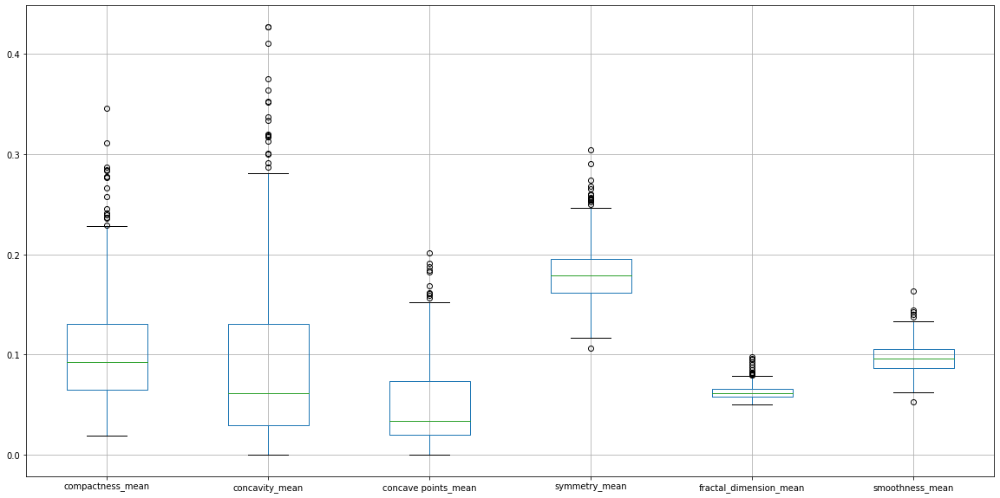

In [ ]:
columns_1 = ['compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'smoothness_mean']
plt.figure(figsize=(20,10))
df.boxplot(columns_1)

<AxesSubplot:>

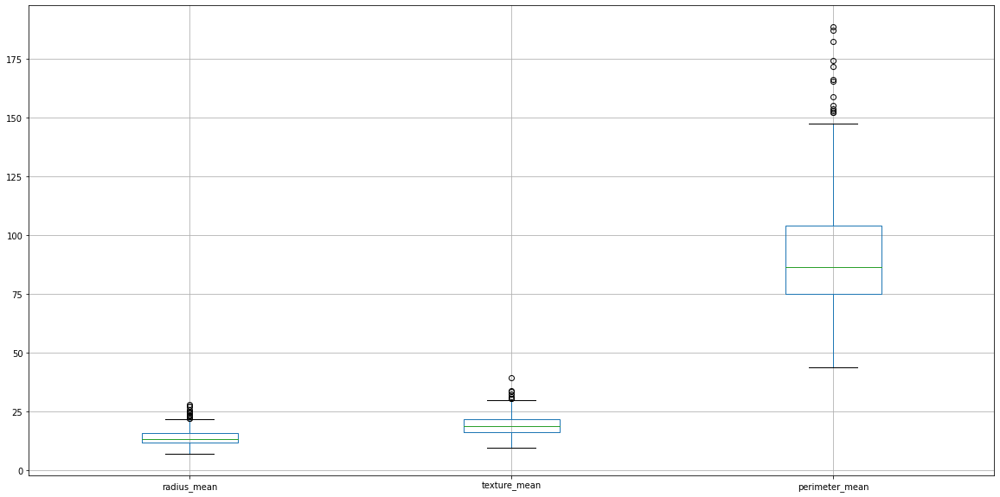

In [ ]:
columns_2 = ['radius_mean', 'texture_mean', 'perimeter_mean']
plt.figure(figsize=(20,10))
df.boxplot(columns_2)


<AxesSubplot:>

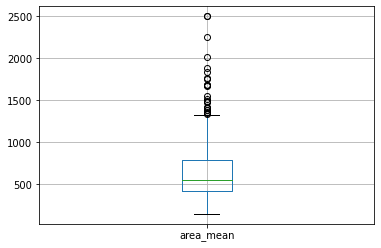

In [ ]:
column3 = ['area_mean']
df.boxplot(column3)

Yes, we can see clear outliers in our dataset e.g. in the example of area mean - area_mean >= 2500 

**Can we rule out some outliers as mistakes in the data collecting process?**

_Your answer here_

**How should we deal with outliers?**

We replace the outliers with Mean values of each column with mean values of the columns.

### Relationship between features (correlations)

**What are the relationships between features (make a pairplot)? Are they linear?**

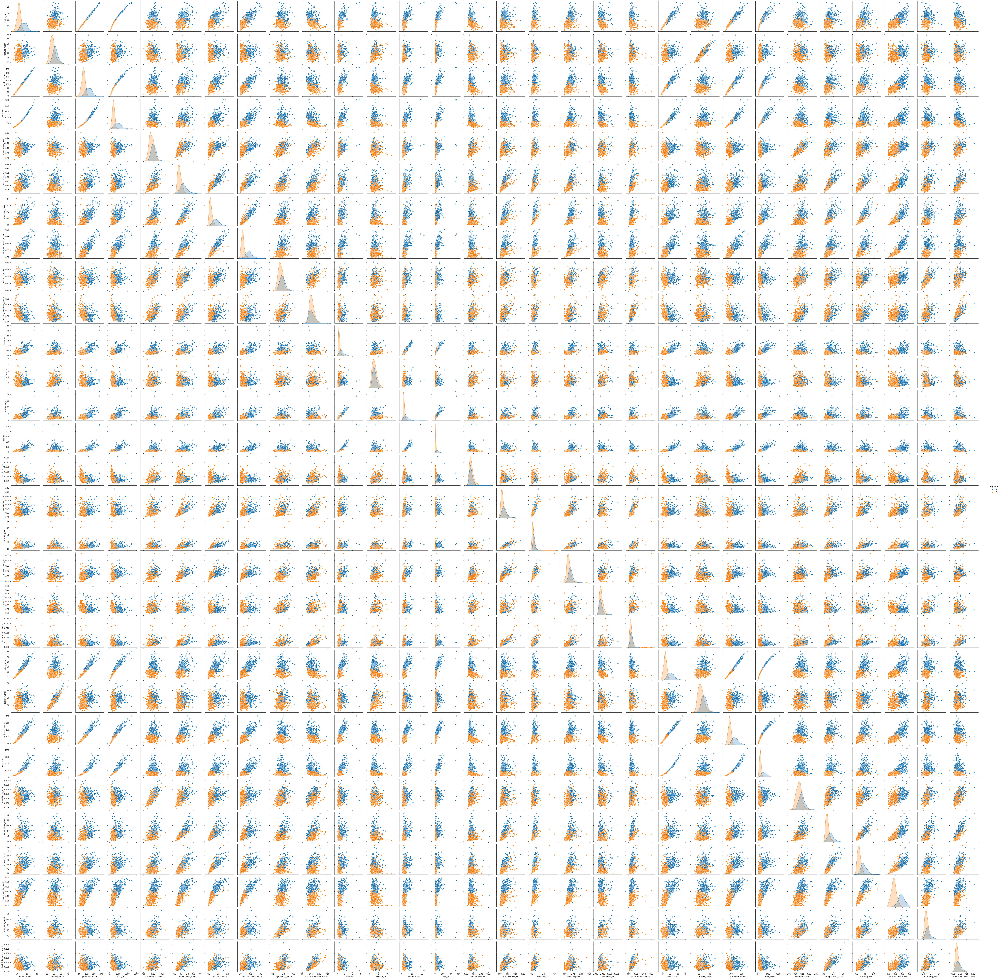

In [ ]:
import seaborn as sns

sns.pairplot(data=df, hue='diagnosis', kind='scatter')
# to show
plt.show()

In [ ]:
X_train.corr().style.background_gradient(cmap='coolwarm')

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.320546,0.997860,0.989138,0.179599,0.520906,0.679632,0.826819,0.143935,-0.307774,0.673440,-0.094188,0.666369,0.754615,-0.224951,0.215414,0.191321,0.369680,-0.087380,-0.038206,0.970064,0.295338,0.965643,0.947156,0.126963,0.442550,0.550485,0.752171,0.173445,0.020650
texture_mean,0.320546,1.000000,0.324712,0.315924,-0.046672,0.222570,0.273926,0.283669,0.065925,-0.089814,0.262474,0.383192,0.269113,0.244026,0.012367,0.175789,0.115784,0.161831,0.009365,0.041100,0.342107,0.913567,0.345405,0.330265,0.052395,0.257609,0.259995,0.278179,0.092812,0.097315
perimeter_mean,0.997860,0.324712,1.000000,0.987970,0.214937,0.571206,0.718109,0.854595,0.178610,-0.257716,0.684850,-0.085371,0.684678,0.762374,-0.207889,0.259812,0.223601,0.399387,-0.065895,-0.002483,0.970137,0.299980,0.971022,0.947577,0.155735,0.484266,0.586113,0.778393,0.198224,0.063842
area_mean,0.989138,0.315924,0.987970,1.000000,0.184989,0.513601,0.688222,0.827476,0.147693,-0.281015,0.721896,-0.067367,0.713778,0.809746,-0.169099,0.223184,0.204756,0.365419,-0.051168,-0.015779,0.962431,0.281755,0.958870,0.959595,0.128769,0.419960,0.536700,0.730864,0.156346,0.015775
smoothness_mean,0.179599,-0.046672,0.214937,0.184989,1.000000,0.652793,0.511073,0.549281,0.545855,0.575029,0.302136,0.026296,0.291223,0.260181,0.290018,0.309875,0.227088,0.358378,0.192488,0.267916,0.220617,0.005286,0.243930,0.215304,0.789737,0.471465,0.423225,0.498175,0.388858,0.496063
compactness_mean,0.520906,0.222570,0.571206,0.513601,0.652793,1.000000,0.883550,0.836639,0.593039,0.554222,0.504459,0.018526,0.558604,0.478572,0.082020,0.728794,0.549840,0.633987,0.209882,0.480600,0.554277,0.230368,0.607913,0.533404,0.537106,0.867293,0.814890,0.818975,0.504105,0.673422
concavity_mean,0.679632,0.273926,0.718109,0.688222,0.511073,0.883550,1.000000,0.920159,0.486308,0.336642,0.623853,0.050991,0.652225,0.627123,0.067931,0.676917,0.687189,0.681465,0.168975,0.446440,0.692255,0.270981,0.732865,0.683586,0.426397,0.763830,0.891956,0.864084,0.405265,0.517176
concave points_mean,0.826819,0.283669,0.854595,0.827476,0.549281,0.836639,0.920159,1.000000,0.447341,0.164655,0.694202,0.006068,0.705538,0.712376,-0.004506,0.497691,0.428967,0.602307,0.092894,0.251379,0.836317,0.281209,0.861200,0.821099,0.437788,0.687991,0.766660,0.912874,0.375737,0.375453
symmetry_mean,0.143935,0.065925,0.178610,0.147693,0.545855,0.593039,0.486308,0.447341,1.000000,0.474216,0.296033,0.119159,0.308190,0.219668,0.168054,0.416174,0.330807,0.387071,0.457545,0.313591,0.180000,0.082456,0.212929,0.173075,0.405752,0.463945,0.417753,0.416768,0.693087,0.414122
fractal_dimension_mean,-0.307774,-0.089814,-0.257716,-0.281015,0.575029,0.554222,0.336642,0.164655,0.474216,1.000000,0.013695,0.131758,0.057072,-0.081974,0.347595,0.564564,0.443585,0.347700,0.327576,0.677782,-0.248226,-0.074702,-0.199931,-0.227477,0.470060,0.444237,0.331185,0.171683,0.324166,0.753951


As we can see the relationship of the some features are linear perimeter & area and radius & perimeter and area&radius but not all of them


**What correlation coefficients should be computed?**

Standard Pearson Correlation Coefficients are fine!

**Is there risk of data leakage?**

None

### Feature Creation and Combination



- **What kind of Scaling should we use/try?**
- **Should we transform some features?**
- **Should we drop some features?**
- **Should we combine features?**

When building Machine learning models, we need to encode categorical variables into numerical values that can be fed to a model.
Since our variables have no order, we can use one hot encoding. 

In [ ]:
# # your code here
# #encode string columns

# encoder = LabelEncoder()
# df['diagnosis'] = encoder.fit_transform(df['diagnosis'])

 <!-- _Your Comments here_ 

We transformed only the columnn of "diagnosis" to numerical data. 0 - benign, 1- malignant. All other colums are not categorical columns. Regarding last "Unnamed 32 " column we didn't why because we will simply drop this column wothout any transformations. -->

In [ ]:
X_train.columns

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [ ]:
# Print features with catagory type
for column in X_train.select_dtypes(include=['object']):
    print(f'Column {column} has {len(X_train[column].unique())} categories: {X_train[column].unique()}\n')

From the above output, the train datasets has no categorical feature that needs encoding or transformation.

**_What do you observe?_**

From the above output, the train datasets has no categorical feature that needs encoding or transformation. 

Transformation would be done one only the y variable.

In [ ]:
num_variables = [ 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst']

In [ ]:
# ohe_variables = ['diagnosis']

### Conclusion: Experimental setup and  Possible Feature Transformations

Let's wrap up on the exploratory data analysis and conclude. We should now be able to answer the following questions:

- **What would be our baseline for the analysis?**
- **What kind of modelling setup should we use/try?**
- **What kind of Scaling should we use/try?**
- **If outliers, what kind of treatment should we apply?**
- **Should we transform some features?**
- **Should we drop some features?**
- **Should we combine features?**

**_write a small paragraph answering these questions_**



Our problem is a binary classification problem. We could start by using the logistic regression model.

We ordered the relevant variables into 2 groups:

- ohe_variables: variables to encode with the OneHotEncoder
- num_variables: numerical variables.

No column in our dataset contains any missing value

Finally, we will have to scale our numerical variables, so that each column we consider in our model has the same weight.

<a id='P2' name="P2"></a>
## [Modelling](#P0)

### Pipeline Definition

In [ ]:
numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='constant', fill_value=0)),
                                      ('scaler', StandardScaler())])

In [ ]:
# ohe_transformer = OneHotEncoder(handle_unknown='ignore')

In [ ]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, num_variables)
        ])

In [ ]:
classification_model = Pipeline(steps=[('preprocessor', preprocessor),
                                          ('classifier', LogisticRegression())])

In [ ]:
classification_model

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['radius_mean',
                                                   'texture_mean',
                                                   'perimeter_mean',
                                                   'area_mean',
                                                   'smoothness_mean',
                                                   'compactness_mean',
                                                   'concavity_mean',
                                                   'concave points_mean',
                                                   'symmetry_mean',
                                                   'fractal_dimension_mean...
                                                   'perimeter_se', 'area_se',
                                                   'smoothness_se',
                                                   'compactness_se',
                                                   'concavity_se',
                                                   'concave points_se',
                                                   'symmetry_se',
                                                   'fractal_dimension_se',
                                                   'radius_worst',
                                                   'texture_worst',
                                                   'perimeter_worst',
                                                   'area_worst',
                                                   'smoothness_worst',
                                                   'compactness_worst',
                                                   'concavity_worst',
                                                   'concave points_worst',
                                                   'symmetry_worst',
                                                   'fractal_dimension_worst'])])),
                ('classifier', LogisticRegression())])

#### Model Cross Validation

In [ ]:
cross_val_score(classification_model, X_train, y_train)

array([1.        , 0.97802198, 0.98901099, 0.95604396, 0.95604396])

### Model Training

In [ ]:
# Your code here
classification_model.fit(X_train, y_train)

Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(fill_value=0,
                                                                                 strategy='constant')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  ['radius_mean',
                                                   'texture_mean',
                                                   'perimeter_mean',
                                                   'area_mean',
                                                   'smoothness_mean',
                                                   'compactness_mean',
                                                   'concavity_mean',
                                                   'concave points_mean',
                                                   'symmetry_mean',
                                                   'fractal_dimension_mean...
                                                   'perimeter_se', 'area_se',
                                                   'smoothness_se',
                                                   'compactness_se',
                                                   'concavity_se',
                                                   'concave points_se',
                                                   'symmetry_se',
                                                   'fractal_dimension_se',
                                                   'radius_worst',
                                                   'texture_worst',
                                                   'perimeter_worst',
                                                   'area_worst',
                                                   'smoothness_worst',
                                                   'compactness_worst',
                                                   'concavity_worst',
                                                   'concave points_worst',
                                                   'symmetry_worst',
                                                   'fractal_dimension_worst'])])),
                ('classifier', LogisticRegression())])

#### autoML

In [ ]:
# your code here
columns = num_variables.copy()

In [ ]:
X_train_encoded = pd.DataFrame(classification_model['preprocessor'].transform(X_train), columns=columns)

Encode feature 'diagnosis' with label encoder

In [ ]:
le = preprocessing.LabelEncoder()
le.fit(y)
y_train_encoded = le.transform(y_train)

In [ ]:
automl = autosklearn.classification.AutoSklearnClassifier(
    time_left_for_this_task=600,
    per_run_time_limit=30,
)

In [ ]:
automl.fit(X_train_encoded, y_train_encoded)

AutoSklearnClassifier(per_run_time_limit=30, time_left_for_this_task=600)

In [ ]:
profiler_data= PipelineProfiler.import_autosklearn(automl)
PipelineProfiler.plot_pipeline_matrix(profiler_data)

### Model Evaluation

In [ ]:
X_test_encoded = pd.DataFrame(classification_model['preprocessor'].transform(X_test), columns=columns)

In [ ]:
y_pred = automl.predict(X_test_encoded)

In [ ]:
y_test_encoded = le.transform(y_test)

In [ ]:
confusion_matrix(y_test_encoded,y_pred)

array([[72,  0],
       [ 2, 40]])

In [ ]:
ConfusionMatrixDisplay(confusion_matrix(y_test_encoded,y_pred))

In [ ]:
explainer = shap.KernelExplainer(model = automl.predict, data = X_test_encoded.iloc[:50, :], link = "identity")

In [ ]:
# Set the index of the specific example to explain
X_idx = 0
shap_value_single = explainer.shap_values(X = X_test_encoded.iloc[X_idx:X_idx+1,:], nsamples = 100)
X_test.iloc[X_idx:X_idx+1,:]
# print the JS visualization code to the notebook
shap.initjs()
shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_value_single,
                features = X_test_encoded.iloc[X_idx:X_idx+1,:]
                )

In [ ]:
shap_values = explainer.shap_values(X = X_test_encoded.iloc[0:50,:], nsamples = 100)

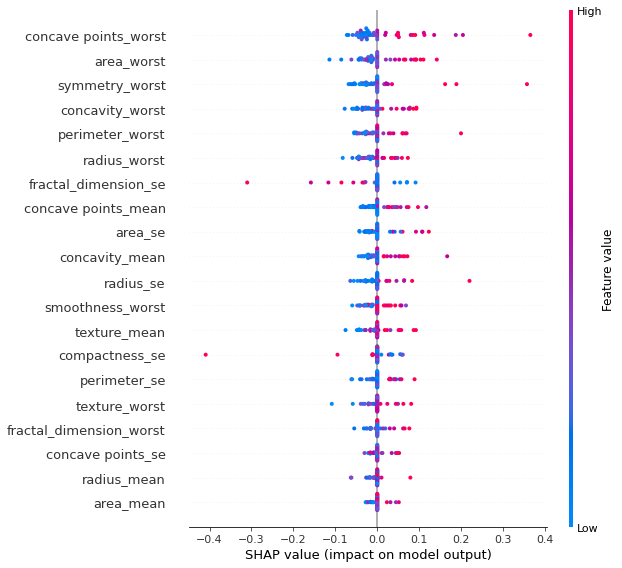

In [ ]:
# print the JS visualization code to the notebook
shap.initjs()
shap.summary_plot(shap_values = shap_values,
                  features = X_test_encoded.iloc[0:50,:]
                  )

_Your Comments here_

--------------
# End of This Notebook